# Tutorial Notebook for Profile Variation Analysis
_Author: Renee Spiewak_

This notebook will demonstrate the key steps of the PCA+GP profile variation analysis through use of a simulated dataset. To simply test the functions, hit the fast-forward button to run all cells and scroll through to check for errors; or run the executable version of this script:
> `python testing_prof_analysis.py`

using optional arguments `-b` and `-d` to switch to a dark background for plots and to set the output directory for plots, respectively. 


## Outline

1. Producing the dataset - A set of ''observations'' with varying noise (white noise only for now), a phase drift over time, and various types of profile variation are generated automatically. If desired, the ''average profile'' can be generated first and used to produce the ''observations''. 

2. Cleaning and aligning the dataset - Following the exact procedure used for real data, the simulation dataset is cleaned and aligned. The second ''Joy Division''-style waterfall plot should be examined to ensure the alignment of all ''observations''. 

3. Running the PCA - The aligned profiles are passed through a standard PCA tool to extract eigenvectors and eigenvalues. The plot of eigenvalues (for the most significant eigenvectors) over time should be examined for outliers. (Mis-aligned ''observations'' will result in an extraneous eigenvector.) 

4. Running the GPs - The cleaned eigenvalues are passed to a function to determine the GPs using MCMC. For each eigenvalue, a plot of the chain and ''corner'' plot are generated; for this fairly ideal dataset, these should be clean and smooth (e.g., roughly Gaussian distributions in the corner plots). The final best GPs are plotted on top of the eigenvalues for each eigenvector in a summary plot, and the ''reconstructed'' profiles (with the mean subtracted) are shown in a waterfall plot. 



In [1]:
# Jupyter magic to automatically reload specified packages
%load_ext autoreload


In [2]:
import os, sys
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import colors as col
import cmasher as cmr
from sklearn.decomposition import PCA
import corner
import george
from george import kernels
import emcee
import scipy.optimize as op
import multiprocessing as mpr
mpr.set_start_method('fork')
from all_prof_functions import (aligndata, smart_align, calc_snr, plot_joydivision, make_fake_obss,
                                make_fake_profile, add_gauss, do_rem_aln, #check_null_prob,
                                read_pdv, _find_off_pulse, err_eigval, find_eq_width_snr,
                                get_gp, run_each_gp, plot_eig_gp, plot_recon_profs)
try:
    from all_prof_functions import check_null_prob
except ImportError:
    print("Cannot do nulling analysis")

%aimport -os -sys -np -plt -col -cmr -sklearn.decomposition -george -emcee -op -mpr -corner
%autoreload 2


In [3]:
# Set up some plotting stuff
plt.rcParams["figure.figsize"] = (6, 10)
plt.rc('savefig', bbox='tight')
use_bk_bgd = True #### Change this to use white backgrounds for plots  #####
if use_bk_bgd:
    plot_style = 'dark_background'
    # The CMasher package provides lots of lovely colour maps; chroma is a handy sequential cmap
    cmap = cmr.chroma_r
    c1 = cmap(0.0)
    c2 = cmap(0.1)
    c3 = cmap(0.33)
    c4 = cmap(0.55)
    c5 = cmap(0.68)
    c6 = cmap(0.815)

else:
    plot_style = 'default'
    cmap = cmr.chroma
    c1 = cmap(0.0)
    c2 = cmap(0.3)
    c3 = cmap(0.53)
    c4 = cmap(0.65)
    c5 = cmap(0.78)
    c6 = cmap(0.915)


## Simulating a dataset

The real data you will use for the profile variation analysis will contain profiles in a 2D numpy array (phase bins vs. observation number), MJDs in a 1D array, and observation lengths in a 1D array (not used in this version of the analysis pipeline). In order to test the analysis functions, these 3 data products must be simulated. 


### Generating a fake average profile

The ''profiles'' are generated based on an input profile or by adding a number of Gaussian components with white noise. For >1 Gaussian components, the centre bin, width, and amplitude are adjusted using normally- or lognormally-distributed random numbers. For >2 Gaussian components: If `no_ip` is set to False, at least one component will be shifted by `nbin/2` bins, simulating an interpulse. If `no_ip` is set to True, no components will be shifted to form an interpulse (although the normal distribution of phase shifts allows for significant separation of components). 

If you later see that the alignment of profiles is failing, I recommend generating a profile with fewer components, or where the components significantly overlap (i.e., the separation of centre bins is less than the widths). 


In [4]:
# The function to generate an ''average'' profile
make_fake_profile?


Signature:
make_fake_profile(
    ncomp=2,
    noise_sigma=0.02,
    nbin=512,
    no_ip=None,
    not_wide=False,
)
Docstring:
Produce a fake profile with the given number of Gaussian components
If ncomp > 2, profile may (10% chance) have a main pulse and interpulse
Can also guarantee presence (or absence) of an interpulse

Input:
    ncomp - int, the number of distinct Gaussian components to compose
        the profile
    noise_sigma - float, the ''scale'' of the normal distribution for
        generating white noise on top of the components, relative to
        a profile height of roughly 1;
        `None` indicates a noiseless profile, just the Gaussian components
    nbin - int, the number of phase bins for the profile
    no_ip - bool or None, whether to prohibit or guarantee the presence
        of an interpulse (True/False) or leave it to chance (None)
    not_wide - bool, whether to prevent the components from being too wide
        
Output:
    a 1D numpy array of length `nb

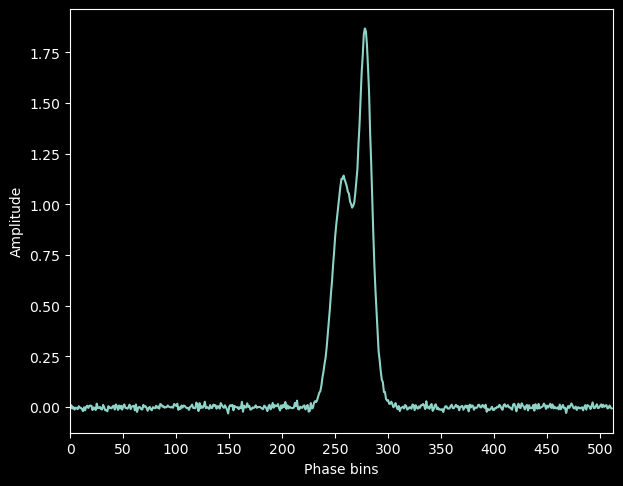

In [5]:
# generate a normal noisy profile but save the parameters to make a noiseless version later
prof, cens, wids, hits = make_fake_profile(4, 0.01, no_ip=True, not_wide=True)

with plt.style.context(plot_style):
    plt.clf()
    fig = plt.figure(num=1)
    fig.set_size_inches(7, 5.5)
    plt.plot(prof)
    plt.xlim(0, len(prof))
    _ = plt.xticks([i*50 for i in range(1+int(np.floor(len(prof)/50)))])
    plt.xlabel('Phase bins')
    plt.ylabel('Amplitude')
    plt.show()


My initial guess (overestimate) is 71
The number of trials was 103


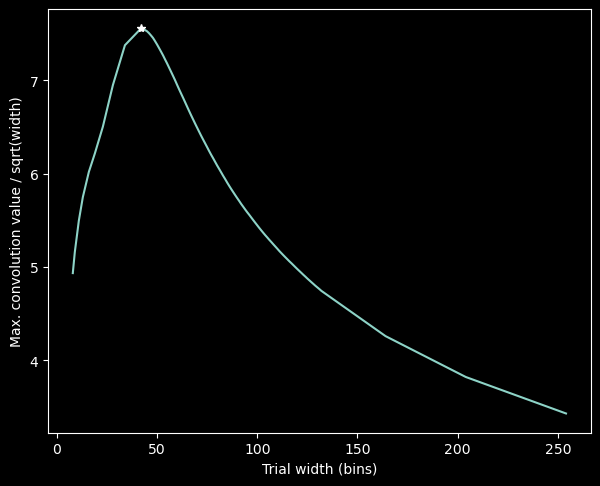

The equivalent width is 42 bins, and the S/N is 744.109


In [6]:
# this cell just demonstrates the method used to find the width of the profile
width, snr = find_eq_width_snr(prof, verb=True, plot_style=plot_style)
print("The equivalent width is {:d} bins, and the S/N is {:.3f}".format(width, snr))


### Simulating a realistic set of observations

The following function attempts to simulate a dataset that is realistic enough to test the PCA and GP parts of this analysis. For each ''observation'':
0. An array of sorted MJD values is generated to represent observation epochs such that `max(mjds) - min(mjds) > nobs*2`, with each successive value separated by at least 0.9 days but no more than `nobs/20`. 

1. A known ''average profile'' can be given (as a numpy array of floats), or a profile will be generated as above with the given number of components and phase bins. WIP: If an ''average profile'' is provided rather than generated inside the function, the shape is treated as single Gaussian for the determination of Gaussian parameters for the next step. 

2. If shape variations is desired: Using the ''average profile'' as a starting point, between 1 and 3 ''eigenvectors'' are produced using a single Gaussian component each, with parameters based on those of the ''average profile'' with random variations. The ''eigenvalues'' are generated for each ''observation'' based on the chosen (or randomly selected) pattern:
    1. Quasi-periodic variations (`qp`) - an offset sinusoid with a timescale between `mjd_range/30` and `mjd_range/10` (i.e., so that between 10 and 30 periods are ''observed'') is used as the base, upon which random variations in both time and amplitude are applied. 
    
    2. Bimodal variations (standard; `bi`) - a boxcar-like function with a timescale between `mjd_range/30` and `mjd_range/5` is used as the base, with the amplitude alternating between 0 and 1 (normal distributions around those values). 
    
    3. Bimodal variations (quick; `bi_quick`) - like the above but with a shorter timescale, chosen from a lognormal distribution with a median value of twice the mean lag between MJDs
    
    4. Random variations (`random`) - with no timescale set, the amplitude of the eigenvalues are simply drawn from a offset lognormal distribution with a median value around 1 (minimum value less than 0, maximum greater than 10)
    
3. An array of ''observation lengths'' is generated using lognormal distribution with a median value of 900s (increased to 3600s for 30\% of ''observations''). The `tobs` values are used to vary the white noise level of the ''observation'', multiplying by `sqrt(tobs_mean/tobs)`. 

4. If nulling is desired: The timescales given (in days) are used to determine whether the ''pulsar'' switches between states, completely independently from any shape variation (i.e., if the ''pulsar'' is ''off'', the output is simply the noise as normal; when ''on'', the full profile with any shape variation is returned). 

5. If desired, a random, small phase shift can be added for successive ''observations'', representing an increasingly incorrect phase solution. This is useful for testing the alignment function. 


The mode is qp with a timescale of 277 days, amplitudes of [0.72565677], and offsets of [0.36282838]


<Figure size 600x1000 with 0 Axes>

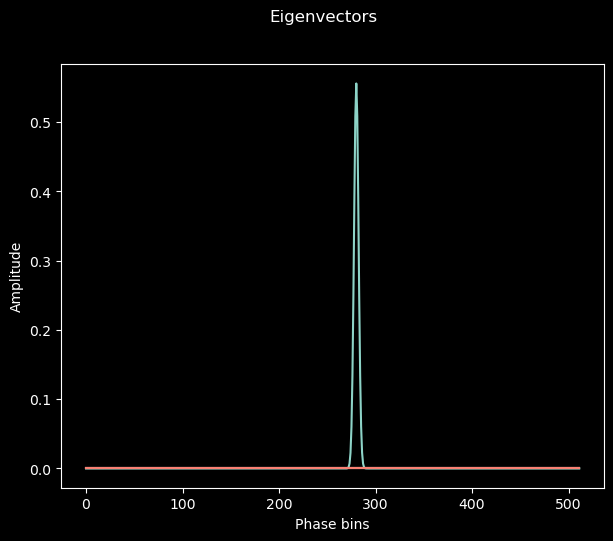

In [7]:
## using a newly-generated average profile with nulling, and no shape variation or phase misalignment
#fakedata, fake_mjds, fake_tobs = make_fake_obss(avg_shape=3, nobs=500, nbin=512, shape_change=False,
#                                                null_time=10, on_time=20, # these values are in days
#                                                verb=True, plot_style=plot_style, no_misalign=True)

# using a previously generated profile (noiseless) with with quasi-periodic shape variation and phase misalignment, and no nulling
prof_noiseless = np.zeros(512)
for icomp in range(len(cens)):
    prof_noiseless = add_gauss(prof_noiseless, cens[icomp], wids[icomp], hits[icomp])

fakedata, fake_mjds, fake_tobs = make_fake_obss(avg_shape=prof_noiseless, nobs=1000, shape_change='qp', null_time=None,
                                                verb=True, plot_style=plot_style, no_misalign=True,# strong=True,
                                                show_plot=True)


<Figure size 600x1000 with 0 Axes>

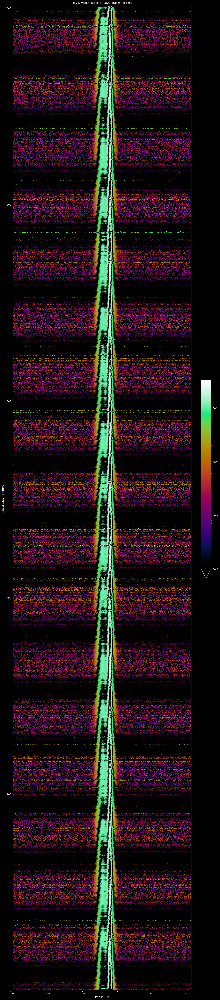

In [8]:
# plot this dataset
plot_joydivision(fakedata, 'test', savename=None, bk_bgd=use_bk_bgd)


<Figure size 600x1000 with 0 Axes>

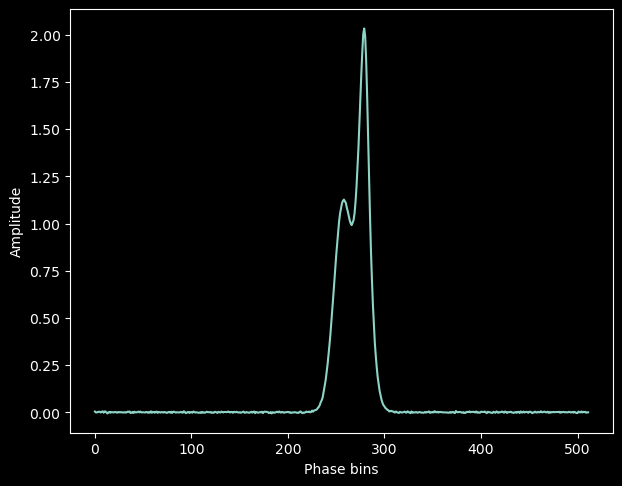

In [9]:
# Plot the actual average profile
# This will look terrible for a dataset with phase misalignment
with plt.style.context(plot_style):
    plt.clf()
    fig = plt.figure()
    fig.set_size_inches(7, 5.5)
    plt.plot(np.mean(fakedata, axis=1))
    plt.ylabel('Amplitude')
    plt.xlabel('Phase bins')
    plt.show()
    

## Cleaning and aligning profiles

The cleaning of profiles is done in 3 stages. These, plus the alignment function and normalisation, are performed in a pipeline function `do_rem_aln()`. 

The cleaning stages:
1. Cleaning based on statistics, using `rem_base_outs()` - 3 checks are done on the data, using the off-pulse rms, pulse width, and S/N. For each, a threshold is applied in terms of standard deviations. 
    1. For the off-pulse rms, the cut is `all_rms < rms_med + all_rms.std()*threshold` where `rms_med` is the median off-pulse rms. Note that alignment of the profiles is not guaranteed at this stage, so the rms in several phase windows is compared and the minimum used for this cut. 
    
    1. For pulse width, the cut is `abs(all_wid - wid_men) < wid_thrsh*wid_std`  where `wid_men` is the mean width and `wid_thrsh` is `3.5*threshold` for a broad distribution of pulse widths and `2*threshold` otherwise. 
    
    2. Optional: The cut on S/N is `all_snr > max(snr_med - all_snr[good_snr].std()*threshold, 5)`, where `snr_med` is the median S/N (after trimming failed S/N calculations with the `good_snr` mask), and a standard minimum threshold of S/N \> 5 is applied. 
    
2. A list of known ''bad'' observations can be given using the `bad_mjds` keyword (a list of MJDs); observations with these MJDs are removed after stats-based cleaning. 

3. After the profiles are aligned as described below, a more accurate determination of the off-pulse rms is made, with `rem_extra_noisy()`. For each profile, an iterative function to find the on- and off-pulse regions is run, and the `True` (off-pulse) values are converted to 1s (0s for `False`). These arrays are summed to form an array of length `nbin` containing values from 0 to `nobs`. Bins with values \> `0.6*nobs` are considered the off-pulse region, making a new mask to apply to the profiles. The rms of this region for all profiles is then calculated, and the cut from step 1.A. applied with these values. 

The profiles are aligned using a correlation between a template (the brightest individual profile) and each individual profile (`xcorr = np.correlate(template, obs, "full")`). After this process, a new template is generated (the average profile) and the process repeated, twice. (WIP: if a better template could be provided, some alignment issues with multi-peak profiles could be fixed.) 

Finally, the profiles are normalised by the sum of on-pulse bins (using the aforementioned iterative function to find the off-pulse region). 


In [10]:
# the whole cleaning and aligning pipeline
do_rem_aln?


Signature:
do_rem_aln(
    data_arr,
    mjds_arr,
    tobs_arr,
    thrsh=1.5,
    bad_mjds=None,
    wide=False,
    logg=None,
    cut_snr=False,
    quiet=False,
)
Docstring:
A pipeline-ish function to remove the baseline, remove bad profiles (including rms outliers and bad MJDs), align the peaks, and make a template.

Input: 
  data_arr : a 2D numpy array of floats with shape (nbin, nprof) representing the input data
  mjds_arr : a 1D numpy array of floats with shape (nprof,) representing MJDs
  tobs_arr : a 1D numpy array of floats with shape (nprof,) representing observation lengths in seconds
  thrsh : float, representing the threshold for trimming outliers based on off-pulse rms
  bad_mjds : list (or numpy array) of floats, representing MJDs to be removed
  wide : bool, whether to assume the distribution of pulse widths is broad (e.g., from shape variation)
  logg : a `logging` object (e.g., from `setup_log()`)
  cut_snr : bool, whether to cut on S/N or leave possible nulls in

In [11]:
# run the fake data through the whole cleaning function
fake_aligned, fake_template, fake_mjds_new, _ = do_rem_aln(fakedata, fake_mjds, fake_tobs, thrsh=1.5,
                                                           cut_snr=False, bad_mjds=None, wide=True, quiet=False)


Number of noisy profiles removed: 50
In total, removed 137 observations, aligned remaining obs., and normalised according to on-pulse sum


<Figure size 600x1000 with 0 Axes>

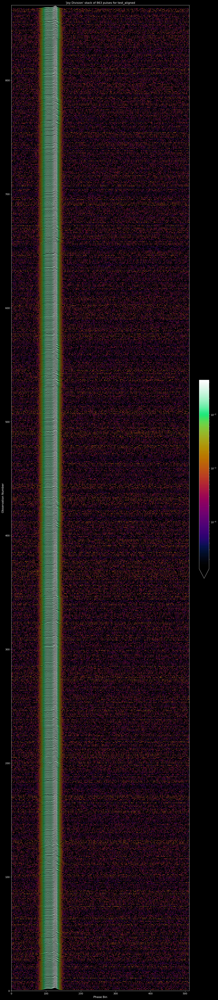

In [12]:
plot_joydivision(fake_aligned, 'test_aligned', savename=None, bk_bgd=use_bk_bgd)


## Running the Principal Component Analysis

### Caveats

PCA is sensitive to misalignment of profiles. Any misaligned profiles will result in one or more extraneous eigenvectors, skewing the analysis and producing outlier eigenvalues, which could cause the GP to fail. You should always check the waterfall plots for misaligned profiles, and then check the eigenvalue plots for significant outliers. The MJDs for any outliers can be given to the `do_rem_aln` function for removal. 

Unless your pulse profile is very wide, it is unwise to include the entire rotation in the PCA as it will look for patterns in the off-pulse which are not relevant to the analysis. Find the rough on-pulse region and make a bin-wise mask (array of booleans). If the profile has an interpulse, that region should be included as well, cutting out any off-pulse region between the MP and IP. 


In [13]:
# set the limits automatically
lim, _ = _find_off_pulse(fake_template)
test_nbin = len(fake_template)
phase = np.linspace(0, 1, test_nbin)
ip = False

# define on-pulse ranges as fractions
one_bin = 1/test_nbin
shift_centre = 0
if len(phase[lim][phase[lim] < 0.25]) == 0:
    print("Need to roll the array to centre the peak at phase=0.5")
    fake_template = np.roll(fake_template, test_nbin//4)
    fake_aligned = np.roll(fake_aligned, test_nbin//4, axis=0)
    lim, _ = _find_off_pulse(fake_template)
    shift_centre = 0.25

peak_min = np.max(phase[lim][phase[lim] < 0.25+shift_centre])-2*one_bin
peak_max = np.min(phase[lim][phase[lim] > 0.25+shift_centre])+2*one_bin
off_min = peak_min - min(peak_min/2, 0.05)
off_max = min(2*peak_max - peak_min, 0.7+shift_centre)
if ip:
    ip_min = 0.71
    ip_max = 0.79
    

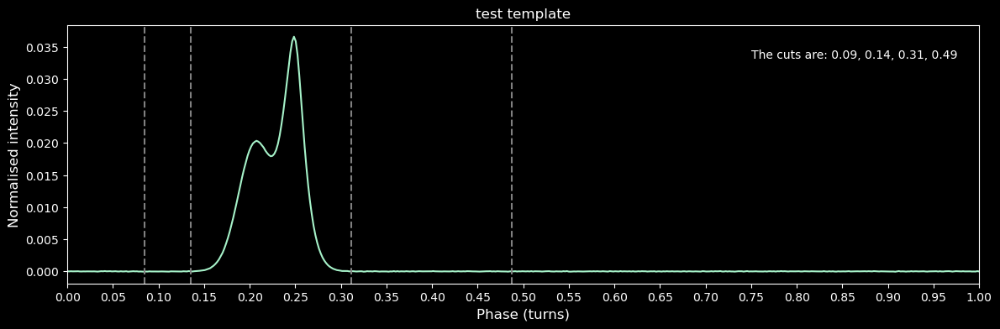

In [14]:
# plot the template to check the on-pulse region
with plt.style.context(plot_style):
    fig = plt.figure(num=1)
    fig.set_size_inches(14, 4)
    ax = fig.gca()
    plt.title("test template")
    test_nbin = len(fake_template)
    plt.plot(np.linspace(0, 1, test_nbin), fake_template, color=c2)
    ylims = plt.ylim()
    plt.vlines([off_min, peak_min, peak_max, off_max], ylims[0], ylims[1], linestyle='dashed', colors='grey')
    plt.ylim(ylims)
    plt.xticks(np.linspace(0, 1, 21))
    plt.xlim(0, 1)
    plt.text(0.75, 0.87, 'The cuts are: {:.2f}, {:.2f}, {:.2f}, {:.2f}'.format(off_min, peak_min, peak_max, off_max), transform=ax.transAxes)
    plt.ylabel('Normalised intensity', fontsize=12)
    plt.xlabel('Phase (turns)', fontsize=12)
    plt.show()


In [15]:
test_bins = np.linspace(0, 1, num=fake_aligned.shape[0], endpoint=False)
test_mask = np.logical_and(test_bins > off_min, test_bins < off_max)
test_off = np.logical_or(test_bins[test_mask] < peak_min, test_bins[test_mask] > peak_max)
if ip:
    test_mask = np.logical_or(test_mask, np.logical_and(test_bins > ip_min, test_bins < ip_max))
    test_off = np.logical_or(test_bins[test_mask] < peak_min, np.logical_and(test_bins[test_mask] > peak_max, test_bins[test_mask] < off_max))
    

With the on- and off-pulse regions defined, you can now use the `PCA` class from `scikit-learn` to find the 30 most significant eigenvectors and associated eigenvalues. (You can change the maximum number of components retained, but 30 should work well for most cases.) 

The `test_pca` object contains many useful attributes, such as the eigenvectors (`test_pca.components_`) and mean profile (`test_pca.mean_`), and the eigenvalues are returned to a separate variable by the `.fit_transform()` function. The shape of the `test_comps_all` numpy array is `(N_obs, N_comp)`, and the shape of `test_pca.components_` is `(N_comp, N_bin)`, where `N_comp` in this case is 30, and `N_bin` is the number of bins remaining in the masked part of the profiles. 


In [16]:
# run the PCA stuff
test_pca = PCA(n_components=30)
test_comps_all = test_pca.fit_transform(fake_aligned[test_mask,:].T)


<Figure size 600x1000 with 0 Axes>

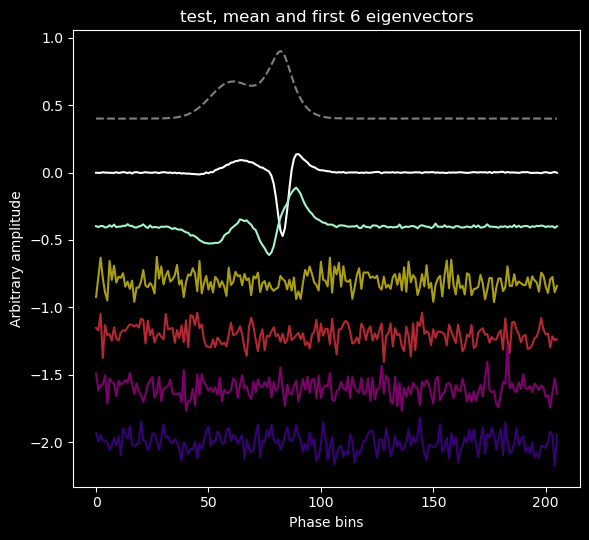

In [17]:
# plot the first six principal components
with plt.style.context(plot_style):
    plt.clf()
    fig = plt.figure()
    fig.set_size_inches(6, 5.5)
    plt.title("test, mean and first 6 eigenvectors")
    plt.plot(0.5*(test_pca.mean_/np.max(test_pca.mean_))+0.4, '--', color='grey')
    plt.plot(test_pca.components_[0,:], color=c1)
    plt.plot(test_pca.components_[1,:]-0.4, color=c2)
    plt.plot(test_pca.components_[2,:]-0.8, color=c3)
    plt.plot(test_pca.components_[3,:]-1.2, color=c4)
    plt.plot(test_pca.components_[4,:]-1.6, color=c5)
    plt.plot(test_pca.components_[5,:]-2, color=c6)

    plt.xlabel('Phase bins')
    plt.ylabel('Arbitrary amplitude')
    plt.tight_layout()
    plt.show()


The uncertainties on the eigenvalues are very useful for identifying outliers, and for accurate GP results. The function to calculate these (using error propagation) requires the full (masked) dataset, the components found by PCA, and the portion of the masked region that is the off-pulse region (as seen above, some off-pulse is included for this reason). 


In [18]:
new_errs = err_eigval(fake_aligned[test_mask,:], test_pca.components_, test_off)


<Figure size 600x1000 with 0 Axes>

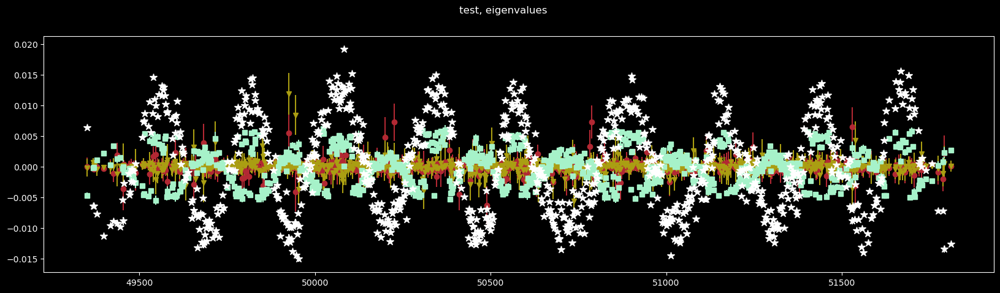

In [19]:
# plot the eigenvalues for the first few components as a function of time
with plt.style.context(plot_style):
    plt.clf()
    fig = plt.figure(figsize=(20, 5))
    fig.suptitle("test, eigenvalues")
    ax1 = fig.gca()
    ax1.errorbar(fake_mjds_new, test_comps_all[:,3], yerr=new_errs[:,3], fmt='o', ecolor=c4, mec=c4, mfc=c4)
    ax1.errorbar(fake_mjds_new, test_comps_all[:,2], yerr=new_errs[:,2], fmt='v', ecolor=c3, mec=c3, mfc=c3)
    ax1.errorbar(fake_mjds_new, test_comps_all[:,1], yerr=new_errs[:,1], fmt='s', ecolor=c2, mec=c2, mfc=c2)
    ax1.errorbar(fake_mjds_new, test_comps_all[:,0], yerr=new_errs[:,0], fmt='*', ecolor=c1, mec=c1, mfc=c1, ms=9)
    plt.show()


## Running the Gaussian Process with Markov Chain Monte Carlo

The final step of the analysis (at this time) is to run GPs on the eigenvalues for the most significant components identified by PCA. This is done with the `george` package, using MCMC (implemented by `emcee`) to optimise the parameters. 

The kernel used in this analysis is the Matern-5/2, which only has a length scale as an independent variable. (There are also a constant and white noise term which will be optimised by the MCMC.) The bounds on the length scale can be derived from the input data: the minimum bound is set to the 99.5th percentile of the separation of observations (so that the GP will not latch onto inter-observation variations), and the maximum is set to half the observed timespan. 

The calculations inside `george` are performed in log-space, so the chains and distributions plotted for each component must be interpreted as such. In addition, the length scale is converted in `george` to `log(length**2)`, so the inverse must be calculated to determine the true length scale for the Matern-5/2 kernel. 

Once the GPs have been run for your selected number of significant components (typically between 2 and 5), a plot will be made showing, for each component, the input eigenvalues over time overlaid with the predictions using the GP median values with uncertainties. This plot is valuable for determining if the GP has succeeded in modeling the eigenvalues for each component. 


The mean lag between observation epochs is 2.85


<Figure size 600x1000 with 0 Axes>

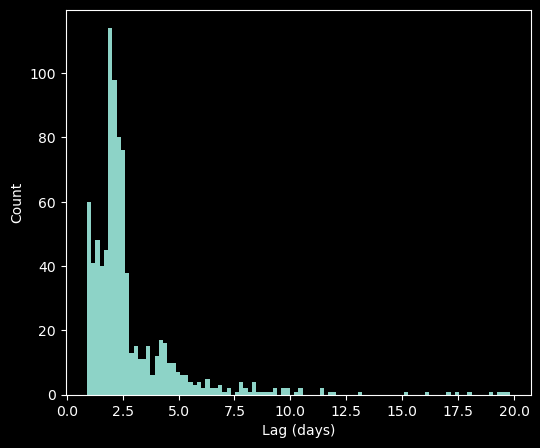

In [20]:
# plot the distribution of lags to ensure the minimum bound on the kernel length is appropriate
with plt.style.context(plot_style):
    plt.clf()
    fig = plt.figure()
    fig.set_size_inches(6, 5)
    lags = fake_mjds_new[1:]-fake_mjds_new[:-1]
    _ = plt.hist(lags, bins=100)
    plt.ylabel('Count')
    plt.xlabel('Lag (days)')
    print("The mean lag between observation epochs is {:.2f}".format(np.mean(lags)))
    plt.show()


The minimum length scale is 9.33
Subtracting 49350 from MJDs (will return true MJD values)
The initial parameter vector is [ 0.00000000e+00  5.50526525e+00 -4.86017186e+00 -1.28646932e-18]
Running burn-in


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:08<00:00, 74.71it/s]


Running second burn-in


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:08<00:00, 67.51it/s]


Running production chain


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6000/6000 [01:55<00:00, 51.80it/s]


The array of autocorrelation times is [45.43073605 44.99438209 42.83178534 44.59568226]
OrderedDict([('kernel:terms[0]:log_sigma', -4.588744389765198), ('kernel:terms[0]:log_rho', 4.715009840239704), ('kernel:terms[1]:log_sigma', -6.065008012921891), ('mean:value', 0.0001315693224316589)])


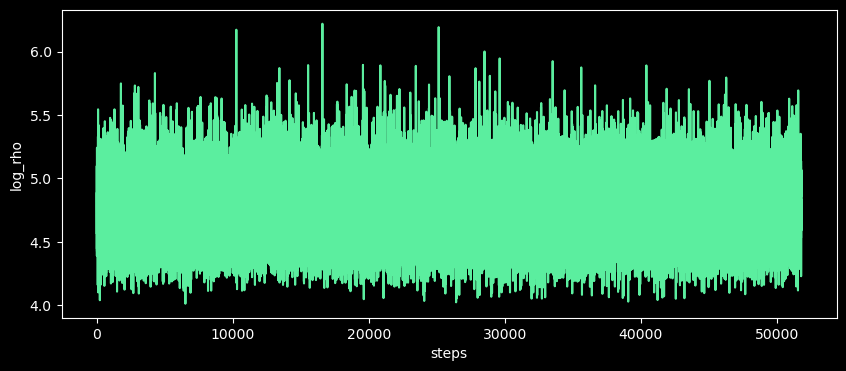

<Figure size 600x1000 with 0 Axes>

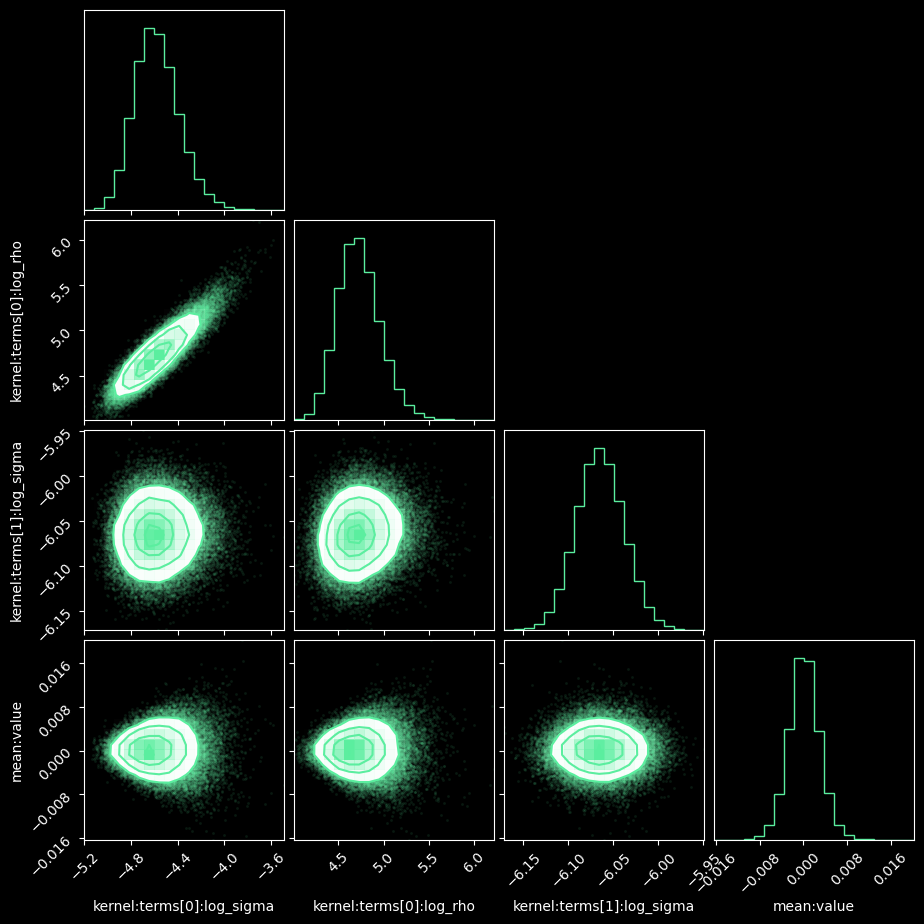

The initial parameter vector is [ 0.00000000e+00  5.50526525e+00 -5.83778626e+00 -3.06340507e-18]
Running burn-in


  0%|                                                                                                                                                                                      | 0/600 [00:00<?, ?it/s]/home/s86932rs/anaconda3/envs/std/lib/python3.10/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:10<00:00, 55.58it/s]


Running second burn-in


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:10<00:00, 56.36it/s]


Running production chain


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6000/6000 [01:44<00:00, 57.55it/s]


The array of autocorrelation times is [48.10347052 54.51827531 47.19912263 47.28609455]
OrderedDict([('kernel:terms[0]:log_sigma', -6.125678984314919), ('kernel:terms[0]:log_rho', 2.992445685369528), ('kernel:terms[1]:log_sigma', -6.19533373069123), ('mean:value', 6.631179044909417e-05)])


<Figure size 600x1000 with 0 Axes>

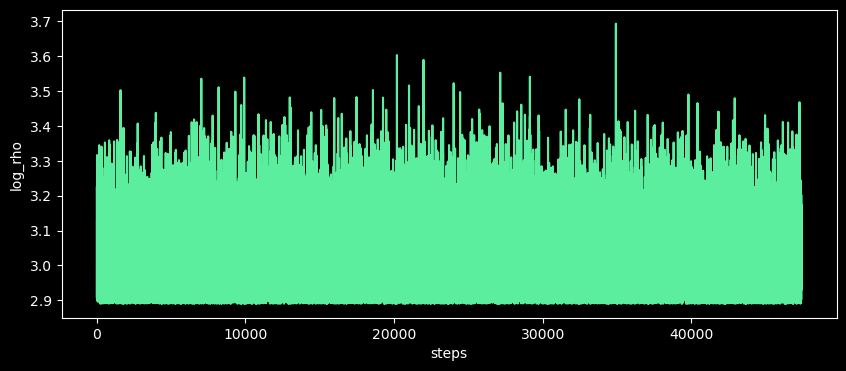

<Figure size 600x1000 with 0 Axes>

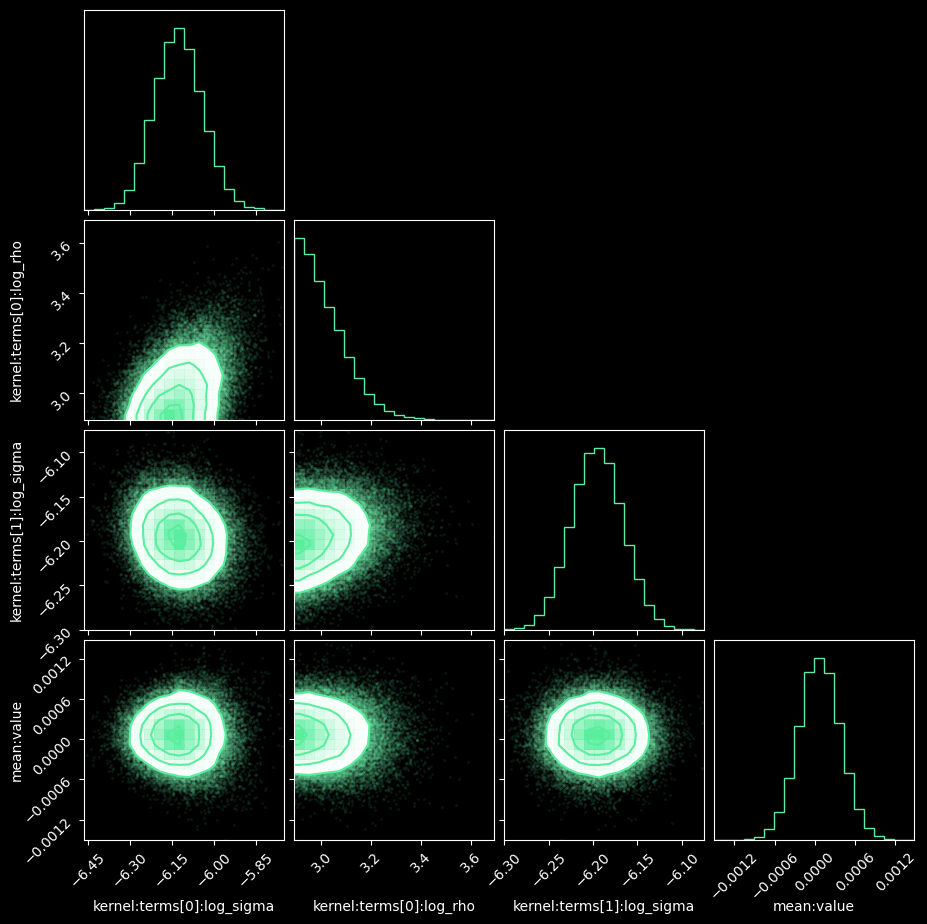

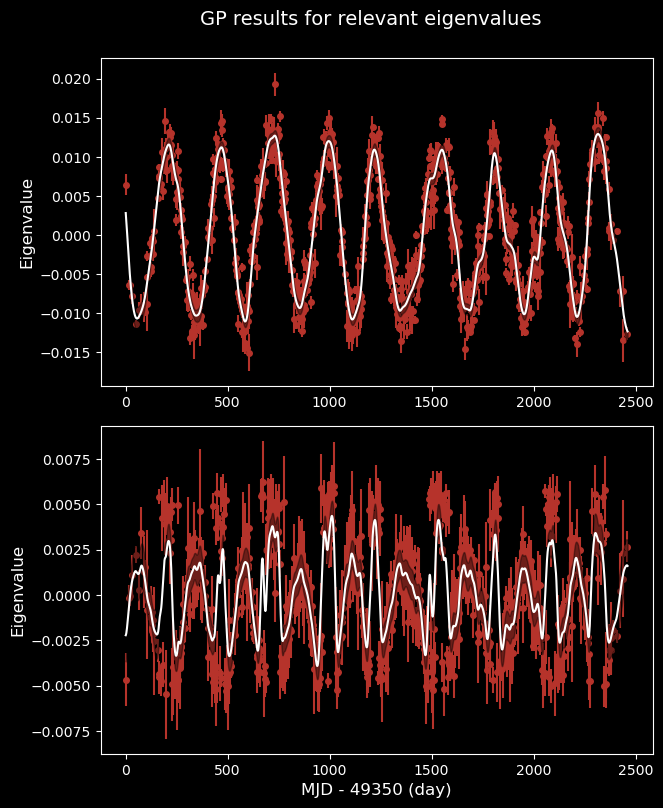

In [45]:
pmin = np.percentile(lags, 97.5)
print("The minimum length scale is {:.2f}".format(pmin))
mjd_range = fake_mjds_new[-1] - fake_mjds_new[0]
kern_len = max(pmin*2, mjd_range/10)

pred_res, pred_vars, mjds_pred = run_each_gp(test_comps_all, fake_mjds_new, new_errs, kern_len=kern_len, max_num=1, prior_min=pmin, prior_max=0.5*mjd_range,
                                             burn_chain=300, prod_chain=3000, num_walkers=200,
                                             long=False, plot_chains=True, plot_corner=True, plot_gps=True, mcmc=True, multi=True,
                                             verb=True, bk_bgd=use_bk_bgd)


Finally, once the GPs are completed and you have the predicted (smoothed) eigenvalues over time, you can reconstruct the profile variations by simply summing the products of the eigenvectors with their eigenvalues over time. While this plot does not show uncertainties on the variations, it is a visually appealing way to examine the profile variations. 


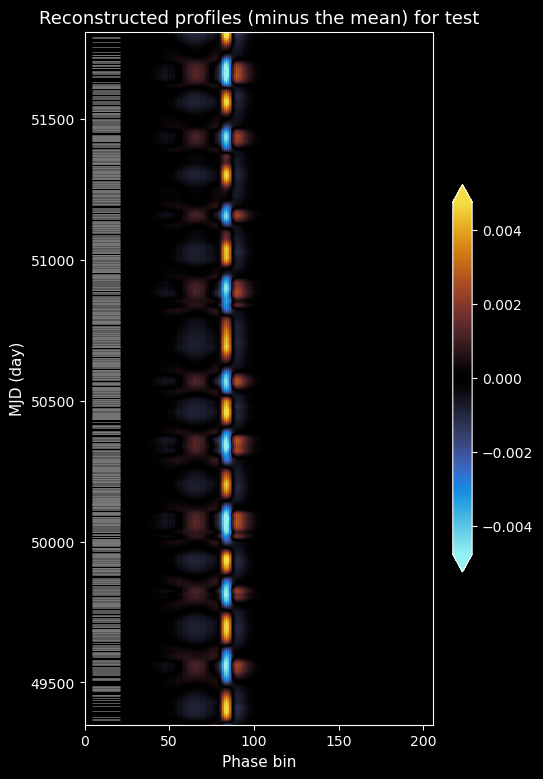

In [38]:
plot_recon_profs(test_pca.mean_, test_pca.components_, mjds_pred, pred_res, 'test', mjds_real=fake_mjds_new,
                 sub_mean=True, savename=None, bk_bgd=use_bk_bgd)


## Nulling Analysis



<Figure size 600x1000 with 0 Axes>

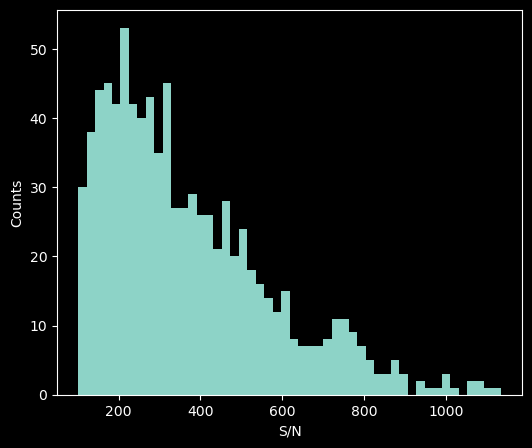

In [25]:
snrs = calc_snr(fake_aligned)
with plt.style.context(plot_style):
    plt.clf()
    fig = plt.figure()
    fig.set_size_inches(6, 5)
    _ = plt.hist(snrs, bins=50)
    plt.ylabel('Counts')
    plt.xlabel('S/N')
    plt.show()


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:02<00:00, 245.64it/s]


<Figure size 600x1000 with 0 Axes>

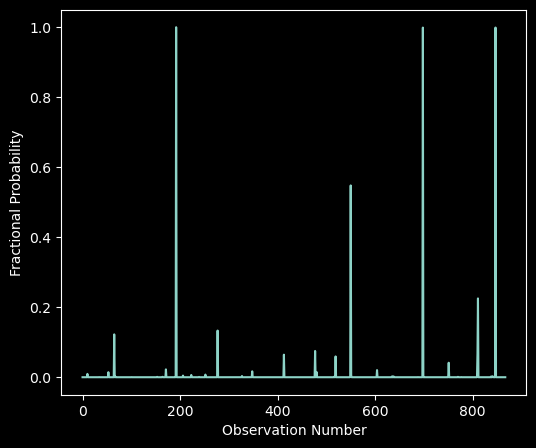

In [26]:
#null_prob = NP.null_probabilities(means_fit, stds_fit, weights_fit, NP.on)
if 'check_null_prob' in globals():
    null_prob = check_null_prob(fake_aligned, peak_bin=128, ip=False, on_min=None, onf_range=None, off_min=None)
    with plt.style.context(plot_style):
        plt.clf()
        fig = plt.figure()
        fig.set_size_inches(6, 5)
        plt.plot(null_prob)
        plt.ylabel('Fractional Probability')
        plt.xlabel('Observation Number')
        plt.show()
else:
    print("Skipping the nulling probability analysis")
    